[Indice](index.ipynb) | Previo: [Problema3Cuerpos.CRTBP](08.01.00.00.Problema3Cuerpos.CRTBP.ipynb) | Siguiente: [Problema3Cuerpos.ConstanteJacobi](08.02.00.00.Problema3Cuerpos.ConstanteJacobi.ipynb)

## 8.5. Solución numérica al CRTBP
<a id='crtbp_numerico'></a>

Como hemos hecho con otros problemas, antes de abordar un tratamiento analítico del CRTBP, estudiaremos aquí la solución numérica de las ecuaciones de movimiento para familiarizarnos con el comportamiento del sistema.

Como hemos aprendido en los capítulos anteriores, para ello necesitamos implementar primero la versión linearizada de la ecuación de movimiento (Eq. [crtbp_uc](#mjx-eqn-eq%3Acrtbp_uc)):

In [1]:
def edm_crtbp(Y,t,alfa):

    r=Y[:3]
    v=Y[3:]
    
    #Vectores relativos
    from numpy import array
    r1=r-array([-alfa,0,0])
    r2=r-array([1-alfa,0,0])
    ez=array([0,0,1])
    
    #Aceleraciones
    from numpy.linalg import norm
    from numpy import cross
    g1=-(1-alfa)*r1/norm(r1)**3
    g2=-alfa*r2/norm(r2)**3
    acen=-cross(ez,cross(ez,r))
    acor=-2*cross(ez,v)
    a=g1+g2+acen+acor

    from numpy import concatenate
    dYdt=concatenate((v,a))
    return dYdt

Escojamos el valor de los parámetros claves de sistema y las condiciones iniciales para la partícula de prueba.

In [5]:
#Parámetro gravitacional del sistem
alfa=0.3

#Tiempos de integración
from numpy import linspace
Nt=1000
ts=linspace(0,10,Nt)

#Condiciones iniciales
from numpy import array,concatenate
ro=array([1.0,0.0,0.0])
vo=array([0.0,0.45,0.0])
Yo=concatenate((ro,vo))

#Solución
from scipy.integrate import odeint
Ys=odeint(edm_crtbp,Yo,ts,args=(alfa,))

Una gráfica de la trayectoria de la partícula en el sistema rotante del CRTBP será:

In [6]:
%matplotlib nbagg

<IPython.core.display.Javascript object>


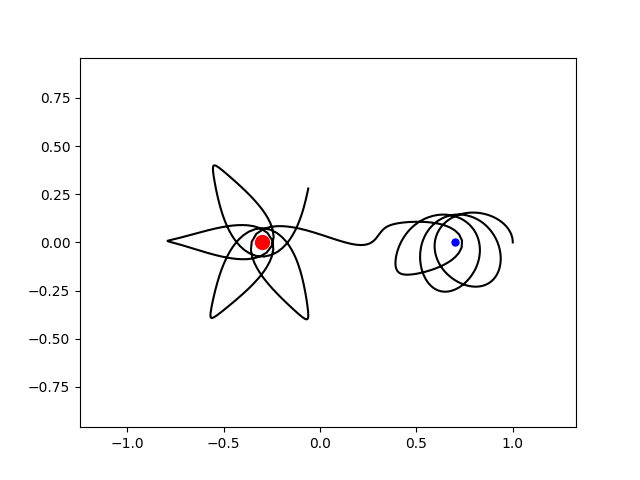

In [7]:
import matplotlib.pyplot as plt
fig=plt.figure()
ax=fig.gca()

rs=Ys[:,:3]
ax.plot(rs[:,0],rs[:,1],'k-')
ax.plot([-alfa],[0],'ro',ms=10)
ax.plot([1-alfa],[0],'bo',ms=5)

from pymcel.plot import fija_ejes_proporcionales
fija_ejes_proporcionales(ax,Ys[:,:2],ycm=0);

<a id='fig:08.01.00.00.Problema3Cuerpos.CRTBP.Numerico_109'></a><center><b>Figura 8.109.</b> </center>

¿Cómo se ve esta extraña trayectoria de la partícula de prueba en el sistema inercial?.  Podemos recuperar la posición (e incluso la velocidad si quisieramos) usando las transformaciones que vimos en la [Sección *Dinámica en sistemas de referencia no inerciales*](05.03.00.00.Mecanica.SistemasNoInerciales.ipynb#sistemas_no_inerciales) y que implementamos como algorítmos en la [Sección *Un ejemplo numérico*](05.03.01.00.Mecanica.SistemasNoInerciales.Numerico.ipynb#ejemplo_numerico_rotante):

In [8]:
from numpy import zeros_like
rs_ine=zeros_like(rs)
r1=zeros_like(rs)
r2=zeros_like(rs)
for i in range(Nt):
    from spiceypy import rotate,mxv
    R=rotate(-ts[i],3)
    rs_ine[i]=mxv(R,rs[i])

    #Posición de las partículas
    from numpy import array,cos,sin
    r1[i]=array([-alfa*cos(ts[i]),-alfa*sin(ts[i]),0])
    r2[i]=array([(1-alfa)*cos(ts[i]),(1-alfa)*sin(ts[i]),0])

Ahora podemos ver la trayectoria de las partículas en los dos sistemas de referencia:

<IPython.core.display.Javascript object>


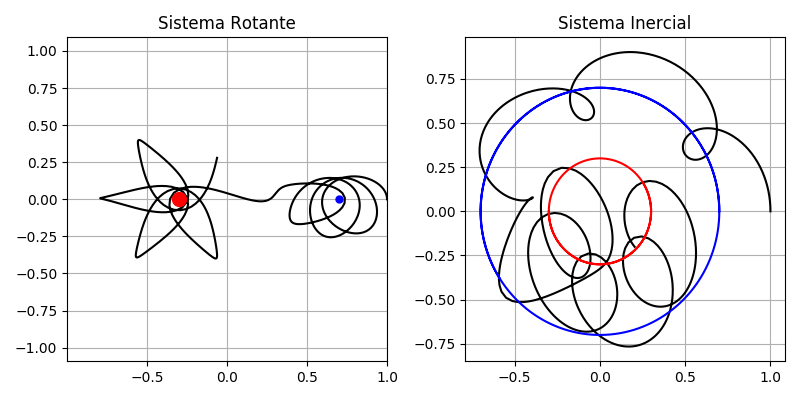

In [9]:
fig,axs=plt.subplots(1,2,figsize=(8,4))

axs[0].plot(rs[:,0],rs[:,1],'k-')
axs[0].plot([-alfa],[0],'ro',ms=10)
axs[0].plot([1-alfa],[0],'bo',ms=5)
axs[0].set_title("Sistema Rotante")
axs[0].grid()
fija_ejes_proporcionales(axs[0],rs[:,:2],ycm=0);

axs[1].plot(rs_ine[:,0],rs_ine[:,1],'k-')
axs[1].plot(r1[:,0],r1[:,1],'r-')
axs[1].plot(r2[:,0],r2[:,1],'b-')
axs[1].set_title("Sistema Inercial")
axs[1].grid()
fija_ejes_proporcionales(axs[0],(rs_ine[:,:2],r1,r2),ycm=0);

fig.tight_layout()

<a id='fig:08.01.00.00.Problema3Cuerpos.CRTBP.Numerico_110'></a><center><b>Figura 8.110.</b> </center>

## 8.6. Un algoritmo general para el CRTBP
<a id='crtbp_algoritmo'></a>

La rutina a continuación permite, usando algunos de los algoritmos presentados en esta sesión, resolver la ecuación de movimiento de una partícula en el CRTBP, tanto en el sistema rotante como en el sistema inercial de referencia. Usaremos esta referencia en otras sesiones de este capítulo, incluyendo la sesión de problemas.

In [18]:
def crtbp_solucion(alfa,ro,vo,ts):
    #Condiciones iniciales
    from numpy import array,concatenate
    Yo=concatenate((array(ro),array(vo)))

    #Solución
    from scipy.integrate import odeint
    Ys=odeint(edm_crtbp,Yo,ts,args=(alfa,))
    rs_rot=Ys[:,:3]
    vs_rot=Ys[:,3:]
    
    #Transformación al sistema inercial de coordenadas
    from numpy import array,zeros_like
    rs_ine=zeros_like(rs_rot)
    vs_ine=zeros_like(vs_rot)
    r1_ine=zeros_like(rs_rot)
    r2_ine=zeros_like(rs_rot)
    ez=array([0,0,1])
    
    for i in range(len(ts)):
        from spiceypy import rotate,mxv,vcrss
        #Transformar al sistema inercial
        R=rotate(-ts[i],3)
        rs_ine[i]=mxv(R,rs_rot[i])
        vs_ine[i]=mxv(R,vs_rot[i]+vcrss(ez,rs_rot[i]))
        #Posición de las partículas masivas
        from numpy import array,cos,sin
        r1_ine[i]=array([-alfa*cos(ts[i]),-alfa*sin(ts[i]),0])
        r2_ine[i]=array([(1-alfa)*cos(ts[i]),(1-alfa)*sin(ts[i]),0])
        
    return rs_rot,vs_rot,rs_ine,vs_ine,r1_ine,r2_ine

### 8.6.1. Animaciones
<a id='crtbp_animaciones'></a>

Podemos usar la rutina escrita anteriormente para crear una animación del movimiento de una partícula de prueba en el sistema inercial y en el sistema rotante del problema CRTBP.  Puede cambiar las condiciones del problema para obtener una mejor comprensión intuitiva del comportamiento del mismo.

<IPython.core.display.Javascript object>


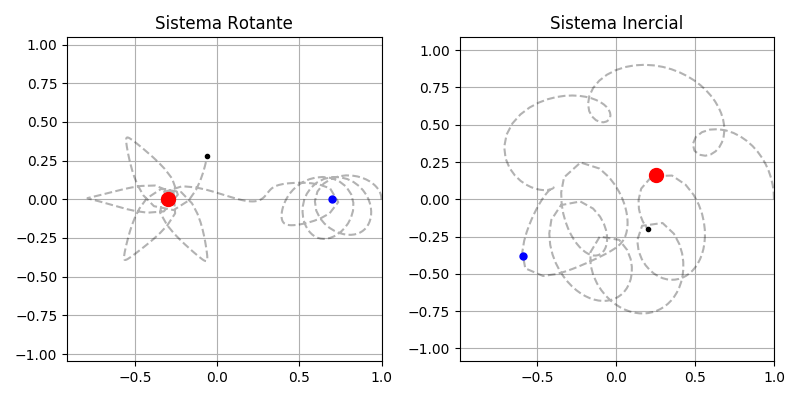

In [35]:
#Tiempos y solucion
from numpy import linspace
Nt=300
ts=linspace(0,10,Nt)
alfa=0.3
ro=[1.0,0.0,0.0]
vo=[0.0,0.45,0.0]
rs_rot,vs_rot,rs_ine,vs_ine,r1_ine,r2_ine=crtbp_solucion(alfa,ro,vo,ts)

#Prepara figura
fig,axs=plt.subplots(1,2,figsize=(8,4))

punto_rot,=axs[0].plot([],[],'k.')
linea_rot,=axs[0].plot(rs_rot[:,0],rs_rot[:,1],'k--',alpha=0.3)
axs[0].plot([-alfa],[0],'ro',ms=10)
axs[0].plot([1-alfa],[0],'bo',ms=5)
axs[0].set_title("Sistema Rotante")
axs[0].grid()
fija_ejes_proporcionales(axs[0],(rs_rot[:,:2],[-alfa,1-alfa]),ycm=0);

punto_ine,=axs[1].plot([],[],'k.')
linea_ine,=axs[1].plot(rs_ine[:,0],rs_ine[:,1],'k--',alpha=0.3)
punto1_ine,=axs[1].plot([],[],'ro',ms=10)
punto2_ine,=axs[1].plot([],[],'bo',ms=5)
axs[1].set_title("Sistema Inercial")
axs[1].grid()
fija_ejes_proporcionales(axs[1],(rs_ine[:,:2],r1,r2),ycm=0);
fig.tight_layout()

#Rutina de animación
def animacion(it):
    punto_rot.set_data(rs_rot[it,0],rs_rot[it,1])
    punto_ine.set_data(rs_ine[it,0],rs_ine[it,1])
    punto1_ine.set_data(r1_ine[it,0],r1_ine[it,1])
    punto2_ine.set_data(r2_ine[it,0],r2_ine[it,1])
    
#Animación
from matplotlib import animation
anim=animation.FuncAnimation(fig,animacion,frames=Nt,interval=5,blit=True,repeat=False);

<a id='fig:08.01.00.00.Problema3Cuerpos.CRTBP.Numerico_111'></a><center><b>Figura 8.111.</b> </center>

In [ ]:
Si desea tener más control sobre la animación puede visualizarla usando el siguiente comando:

In [36]:
from IPython.display import HTML
from matplotlib import rcParams
rcParams['animation.embed_limit']=2**128
HTML(anim.to_jshtml())

[Indice](index.ipynb) | Previo: [Problema3Cuerpos.CRTBP](08.01.00.00.Problema3Cuerpos.CRTBP.ipynb) | Siguiente: [Problema3Cuerpos.ConstanteJacobi](08.02.00.00.Problema3Cuerpos.ConstanteJacobi.ipynb)